<a href="https://colab.research.google.com/github/marcusaure1ius/apollo-dshop/blob/main/PSB_Market_research.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

# Мини ресерч по данным из Apollo сервера 

Во время тестирования и анализа сайта ПСБ-Маркет обнаружилась очень интересная особенность - данные для отображения товаров, категорий и заказов сайт получает из Apollo сервера. Данный сервер необходим для обмена информацией между фронтом и бэкэндом.

Какую информацию позволяет получить данный сервер? Это данные по:
- баннерам (правда там пока один баннер)
- города ПВЗ
- ПВЗ с полным адресами
- Списки категорий с иерархией
- Список категорий с суммарным кол-вом товаров
- Список всех товаров
- Офферные категории

В рамках данной мини исследования я постараюсь выгрузить все эти данные и попытаться провести разведочный анализ.

Спойлер: тестирование выгрузки уже было проведено, так что данные точно есть. Для удобства выгрузки была написана небольшая [библиотечка](https://github.com/marcusaure1ius/apollo-dshop) на python.

**Внимание** - для удобства чтения были удалены блоки с кодом, если вам они зачем-то необходимы - пишите.

# Загрузка библиотек

Загрузим необходимые библиотеки для анализа. Т.к. моей библиотеки нет в pypi, установка будет мануальная

## Загрузка и установки либы с гита

In [ ]:
!git clone https://github.com/marcusaure1ius/apollo-dshop.git

Cloning into 'apollo-dshop'...
remote: Enumerating objects: 65, done.
remote: Counting objects: 100% (65/65), done.
remote: Compressing objects: 100% (46/46), done.
remote: Total 65 (delta 18), reused 60 (delta 13), pack-reused 0
Unpacking objects: 100% (65/65), done.


In [ ]:
%cd apollo-dshop
!python3 setup.py install 

/content/apollo-dshop
running install
running bdist_egg
running egg_info
creating apollodshop.egg-info
writing apollodshop.egg-info/PKG-INFO
writing dependency_links to apollodshop.egg-info/dependency_links.txt
writing top-level names to apollodshop.egg-info/top_level.txt
writing manifest file 'apollodshop.egg-info/SOURCES.txt'
writing manifest file 'apollodshop.egg-info/SOURCES.txt'
installing library code to build/bdist.linux-x86_64/egg
running install_lib
running build_py
creating build
creating build/lib
creating build/lib/apollodshop
copying apollodshop/__init__.py -> build/lib/apollodshop
copying apollodshop/gql_requests.py -> build/lib/apollodshop
creating build/lib/apollodshop/dataloads
copying apollodshop/dataloads/cities.py -> build/lib/apollodshop/dataloads
copying apollodshop/dataloads/categories.py -> build/lib/apollodshop/dataloads
copying apollodshop/dataloads/banners.py -> build/lib/apollodshop/dataloads
copying apollodshop/dataloads/total_products.py -> build/lib/apoll

In [ ]:
!pip install dadata aiographql-client folium nest-asyncio geopandas

Looking in indexes: https://pypi.org/simple, https://us-python.pkg.dev/colab-wheels/public/simple/
     |████████████████████████████████| 1.0 MB 6.5 MB/s 
     |████████████████████████████████| 16.7 MB 39.9 MB/s 
     |████████████████████████████████| 6.3 MB 41.2 MB/s 


## Объявление либ

In [205]:
import pandas as pd
import numpy as np
import asyncio
import logging
import nest_asyncio
import requests
import geopandas
import folium

import plotly
import plotly.io as pio
import plotly.graph_objs as go
import plotly.express as px
from plotly.subplots import make_subplots
import plotly.figure_factory as ff
import matplotlib.pyplot as plt
%matplotlib inline
%config InlineBackend.figure_format='retina'
import seaborn as sns
plotly.offline.init_notebook_mode(connected=True)

nest_asyncio.apply()

from dadata import Dadata
from folium.plugins import MarkerCluster
from tqdm.notebook import tqdm
from aiographql.client import GraphQLClient

from apollodshop.gql_requests import get_dshop_base_info
from apollodshop.dataloads.banners import get_banners_info
from apollodshop.dataloads.categories import get_categories_info, get_low_level_categories
from apollodshop.dataloads.cities import get_cities_info
from apollodshop.dataloads.total_products import get_total_products_info
from apollodshop.dataloads.all_products import get_all_products

# Базовые настройки

В рамках одной из задач данного исследования требовалось получить регионы из адресов ПВЗ, для этого как нельзя кстати подходит API от Dadata. В ячейке ниже зафиксированы токен и секрет для обращения к API. 

Помимо этого также есть несколько констант.

In [ ]:
# API Dadata - данные по адресам
DADATA_TOKEN = '37f0021428683b17b129873a52ee5d8db6ad26a0'
DADATA_SECRET = '26e0bac39a9c00b0f68453818a93d7a3e49ce0aa'

# API OpenRoureService - данные по построению маршрута
ORT_TOKEN = '5b3ce3597851110001cf6248823a92da219047d8ba25e12bb3bf544c'

# URL обращения к Apollo серверу
ENDPOINT_URL = 'https://dshop-only.api.prod.cluster.kznexpess.com/'

# KE Logistic - геоточка основного склада КазаньЭкспресс
ke_lat, ke_long = [55.879988, 49.001032]
GEODATA = '/content/drive/MyDrive/Colab Notebooks/Job/PSB_Market/admin_level_4.geojson'

# Настройки визулизаций
pio.templates.default = "plotly_white"
config = {'displaylogo': False}

# Подготовка функций

Для удобства отображения данных добавим несколько функций визуализации данных

In [ ]:
def stacked_box_n_hist(df, column, title, x_title, y_title, zoom_range):
    """
    Функция для построения интерактивных графиков Plotly, которые состоят из двух подграфиков:
    
    1. График boxplot, который в сжатом виде показывает распределение значение
    2. Гистограмма, которая показывает распределение значений
    
    Также данная фукнция добавляет в построенный график кнопки увеличения и уменьшения размерности оси Х для отображения
    значений без выбросов
    """
    
    # Общие настройки
    pio.templates.default = "plotly_white"
    
    config = {'displaylogo': False}

    fig = go.Figure()
    
    # Сроим фигуру, на которой будет несколько графиков
    fig = make_subplots(
        rows=2, 
        cols=1, 
        subplot_titles=("", ""), 
        row_heights=[0.2, 0.7], 
        vertical_spacing = 0.05
    )
    
    # Добавляем на фигуру грифик Boxplot
    fig.add_trace(
        go.Box(
            x=df[column],
            name='', 
            showlegend=False,
            boxmean=True
        ),
        row=1, 
        col=1
    )
    
    # Добавляем на фигуру гистограмму
    fig.add_trace(
        go.Histogram(
            x=df[column],
            showlegend=False,
            hoverinfo="x",

        ),
        row=2, 
        col=1
    )
    
    # Изменяем оси первого графика
    fig.update_xaxes(
        title_text="", 
        row=1, col=1,
        rangemode="tozero"
    )
    fig.update_yaxes(
        title_text="", 
        row=1, 
        col=1
    )
    
    # Изменяем оси второго графика
    fig.update_xaxes(
        title_text=x_title, 
        row=2, 
        col=1,
        
    )
    fig.update_yaxes(
        title_text=y_title, 
        row=2, 
        col=1
    )
    
    # Изменяем стандартное отображение инфомарции на графике при наведении на значение
    fig.update_traces(
        selector=dict(type='histogram'), 
        hoverlabel=dict(
            bgcolor="white",
            font_size=16,
            font_family="Open Sans", 
        )
    )

    
    fig.update_layout(title=title)
    
    #Настраиваем кнопки и даем и функциональность по увеличению/уменьшению оси Х
    button1 = dict(
        method = "relayout",
        args = [{
            'xaxis.range': zoom_range,
            'xaxis2.range': zoom_range}],
        label = 'Увеличить'
    )

    button2 = dict(
        method = "relayout",
        args = [{'xaxis.autorange': True,
                 'xaxis2.autorange': True,
                 'yaxis.autorange': True,
                 'yaxis2.autorange': True}],
        label = 'Уменьшить'
    )
    
    # Добавляем на фигуру кнопки 
    fig.update_layout(
        updatemenus=[
            dict(
                type = "buttons",
                direction="right",
                showactive=False,
                bgcolor='#fff9ef',
                bordercolor='#052464',
                borderwidth=1,
                xanchor="auto",
                font={'family':"Open Sans", 'size':16},
                x=1,
                y=1.2,
                buttons=[button1, button2]
            )
        ]
    ) 
    

    fig.show(config=config)

In [ ]:
def get_route(start_lon, start_lat, end_lon, end_lat):
    
    loc = "{},{};{},{}".format(start_lon, start_lat, end_lon, end_lat)
    url = "http://router.project-osrm.org/route/v1/driving/"
    r = requests.get(url + loc)
    if r.status_code!= 200:
        return {}

    res = r.json()
    start_point = [res['waypoints'][0]['location'][1], res['waypoints'][0]['location'][0]]
    end_point = [res['waypoints'][1]['location'][1], res['waypoints'][1]['location'][0]]
    distance = round(res['routes'][0]['distance'] / 1000)
    duration = round(res['routes'][0]['duration'] / 60)

    
    out = {
           'start_point': start_point,
           'end_point': end_point,
           'distance': distance,
           'duration': duration
          }

    return out

# Получение и анализ данных

Начнем получать информацию...

## Основная информация по PSB Dshop

Объявим GraphQLClient клиент с указанием URLа эндпоинта сервера + клиент Dadata

In [ ]:
client = GraphQLClient(endpoint=ENDPOINT_URL)
dadata = Dadata(DADATA_TOKEN, DADATA_SECRET)

Все запросы будут асинхронные для более быстрого получения данных. В данном запросе мы получим сразу основную информацию - баннеры, категории, ПВЗ и офферы

In [ ]:
response = asyncio.run(get_dshop_base_info(client))
data = response.data

## Баннеры

Баннеры - это отличный инструмент акцентирования внимания пользователей на ключевых акциях / товарах маркетплейса, выглядит на сайте он так:

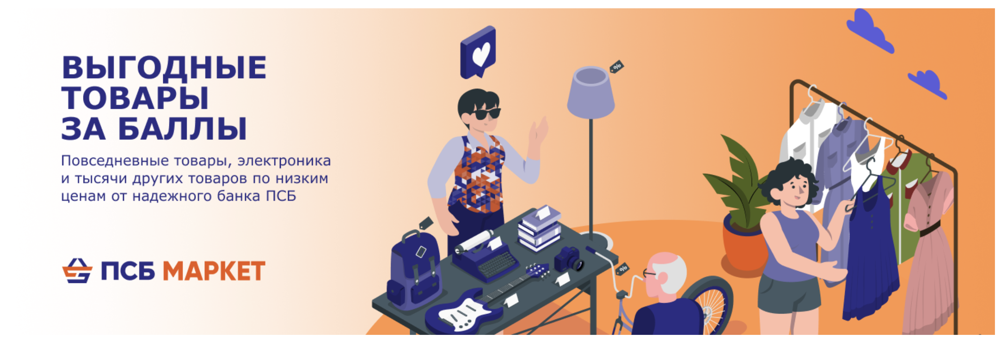

In [ ]:
banners = get_banners_info(data)
banners_df = pd.DataFrame(banners)

Processing banners data: 100%|██████████| 1/1 [00:00<00:00, 6177.18it/s]


In [ ]:
banners_df

,desc,link,image_link_high,type_name
0,None,#,https://ke-images.servicecdn.ru/static/psb/ban...,DshopBanner


Пока что имеем только один баннер и при этом он ни куда не ведет (это специально)

## Категории

Загрузим данные по категориям. Сами категории имеют определенную иерархию:

- 1 уровень, это категории, которые располагаются в хедере сайта. Всего их 19 штук.

- 2 уровень категорий. Они располагаются внутри страницы каждой категории 1 уровня.
- И наконец 3 уровень

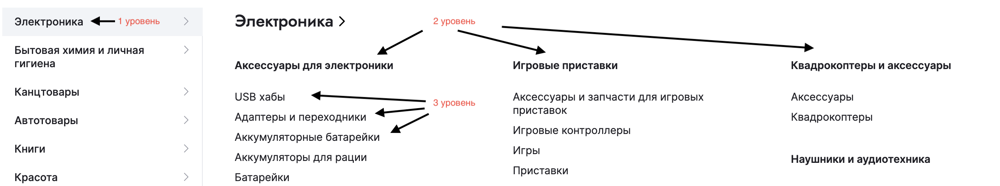



Получим данные по категориям сразу по всем 3 уровням

In [ ]:
categories = get_categories_info(data)
categories_df = pd.DataFrame(categories)
categories_df

100%|██████████| 19/19 [00:00<00:00, 3383.94it/s]


,cat_id_lvl1,title_lvl1,image,cat_id_lvl2,title_lvl2,parent_id_lvl2,cat_id_lvl3,title_lvl3,parent_id_lvl3
0,165,Автотовары,None,166,Автозапчасти,166,186,Автозапчасти автомобильные,166
1,165,Автотовары,None,166,Автозапчасти,166,174,Автосвет,166
2,165,Автотовары,None,166,Автозапчасти,166,172,Двигатель,166
3,165,Автотовары,None,166,Автозапчасти,166,182,Запчасти для ТО,166
4,165,Автотовары,None,166,Автозапчасти,166,168,Кузовные запчасти,166
...,...,...,...,...,...,...,...,...,...
1311,3286,Электроника,None,3491,Фото- и видеотехника,3491,3509,Оборудование для фотографов,3491
1312,3286,Электроника,None,3491,Фото- и видеотехника,3491,3522,Фото- и видеокамеры,3491
1313,3286,Электроника,None,3577,Часы и электронные будильники,3577,3578,Проекционные часы,3577
1314,3286,Электроника,None,3577,Часы и электронные будильники,3577,3580,Радио-будильники,3577


Итого имеем 1316 уникальных категорий. Посмотрим некоторую визуализацию полученных данных

1. Посмотрим на распределние подкатегорий в категориях верхнего уровня:

In [ ]:
grouped_categ_lvl1 = categories_df.groupby(['title_lvl1'])['cat_id_lvl1'].count().reset_index().sort_values('cat_id_lvl1', ascending=False)
fig = px.bar(grouped_categ_lvl1, 
             x='title_lvl1',
             y='cat_id_lvl1',
             text_auto='.2s',
             color_discrete_sequence=["rgb(43, 44, 132)"],
             labels={
                     'title_lvl1': 'Категории верхнего уровня',
                     'cat_id_lvl1': 'Кол-во подкатегорий'
                 },
            title=f"Самое большое кол-во подкатегорий в категории {grouped_categ_lvl1.loc[0]['title_lvl1']}",
            height=600)

fig.update_traces(textfont_size=12, textangle=0, textposition="outside", cliponaxis=False)
fig.update_yaxes(title='Кол-во подкатегорий', visible=True, showticklabels=False)
fig.show()

Наибольшое кол-во подкатегорий в Автотоварах, Канцтоварах и товарах для дома. Но это только категории, теперь посмотрим на кол-во продуктов в этих категориях

## Общее кол-во продуктов

Загрузим данные по суммарным продуктам в категориях

In [ ]:
low_level_cats = get_low_level_categories(categories)
total_products = get_total_products_info(client, low_level_cats)
total_products_df = pd.DataFrame(total_products)

100%|██████████| 1316/1316 [12:33<00:00,  1.75it/s]


In [ ]:
total_products_df['total_products'].sum()

581273

In [ ]:
total_products_df = total_products_df.merge(categories_df, how='left', left_on='category_id', right_on='cat_id_lvl3')
total_products_df.head()

,category_id,total_products,cat_id_lvl1,title_lvl1,image,cat_id_lvl2,title_lvl2,parent_id_lvl2,cat_id_lvl3,title_lvl3,parent_id_lvl3
0,186,373,165,Автотовары,None,166,Автозапчасти,166,186,Автозапчасти автомобильные,166
1,174,1582,165,Автотовары,None,166,Автозапчасти,166,174,Автосвет,166
2,172,178,165,Автотовары,None,166,Автозапчасти,166,172,Двигатель,166
3,182,413,165,Автотовары,None,166,Автозапчасти,166,182,Запчасти для ТО,166
4,168,132,165,Автотовары,None,166,Автозапчасти,166,168,Кузовные запчасти,166


Всего на сайте мы имеет около 600 тыс. продуктов, а рааспределением по категориям следующее:

In [ ]:
grouped_total_prd = total_products_df.groupby(['title_lvl1'])['total_products'].sum().reset_index().sort_values('total_products', ascending=False).reset_index()
fig = px.bar(grouped_total_prd, 
             x='title_lvl1',
             y='total_products',
             text_auto='.2s',
             color_discrete_sequence=["rgb(43, 44, 132)"],
             labels={
                     'title_lvl1': 'Категории верхнего уровня',
                     'total_products': 'Кол-во продуктов'
                 },
            title=f"Самое большое кол-во продуктов в категории {grouped_total_prd.loc[0]['title_lvl1']}",
            height=600)

fig.update_traces(textfont_size=12, textangle=0, textposition="outside", cliponaxis=False)
fig.update_yaxes(title='Кол-во продуктов', visible=True, showticklabels=False)
fig.show()

Как мы видми самые топовые категории по кол-ву продуктов, это Товары для дома и Аксессуары. Попробуем спуститься до категорий нижнего уровня и посмотреть какие там лидеры по продуктам

In [ ]:
total_products_df.groupby(['title_lvl1', 'title_lvl3'])['total_products'].sum().reset_index().sort_values('total_products', ascending=False)

,title_lvl1,title_lvl3,total_products
132,Аксессуары,Бижутерные украшения,30653
1180,Электроника,Аксессуары и запчасти,29436
306,"Дача, сад и огород",Семена,16086
1053,Товары для дома,"Подарочная упаковка, открытки",10693
130,Аксессуары,Аксессуары для волос,10651
...,...,...,...
49,Автотовары,Кантователи и держатели,0
128,Автотовары,Экипировка для снегоходов,0
125,Автотовары,Шины,0
78,Автотовары,Подъемное оборудование,0


In [ ]:
grouped_total_prd = total_products_df.groupby(['title_lvl3'])['total_products'].sum().reset_index().sort_values('total_products', ascending=False).head(10).reset_index()
fig = px.bar(grouped_total_prd, 
             x='title_lvl3',
             y='total_products',
             text_auto='.2s',
             color_discrete_sequence=["rgb(43, 44, 132)"],
             labels={
                     'title_lvl3': 'Категории нижнего уровня',
                     'total_products': 'Кол-во продуктов'
                 },
            title=f"Самое большое кол-во продуктов в категории {grouped_total_prd.loc[0]['title_lvl3']}",
            height=600)

fig.update_traces(textfont_size=12, textangle=0, textposition="outside", cliponaxis=False)
fig.update_yaxes(title='Кол-во продуктов', visible=True, showticklabels=False)
fig.show()

Очень интересно, что в нижних категорий лидеры те, у кого родительская категория 1 уровня совсем не равна предыдущему графику. То есть, например, категория "Аксессуары и запчасти	" - это категория 1 уровня "Электроника", которая была аж на 5 месте в предыдущем графике. Это значит, что 54 товаров Электроники - целых 30 тысяч это различные аксессуары 😀

## Получение всего продуктового каталога

Теперь перейдем к самому интересному - получению данных ВСЕХ продуктов из ПСБ-Маркет, то есть загрузим все полмиллиона товаров. 

Механизм загрузки данных очень интересный - проблема в том, что нельзя просто одним запросом получить условные 30 тыс. товаров, такой объем данных банально не передать. Для этого у КЕ есть механизм получения данных через "страницы" и "позиции". Не смотря на то, что при листании товаров на сайте никаких страниц нет - вы все равно видите плавную подгрузку товаров. Они погружаются по 10 позиций, таким образом и меняются страницы.

Если бы максимум можно было получить 10 позиций, то на каталог в 30 товаров пришлось бы отправить 3 тысячи запросов, благо в Apollo есть возможность получить сразу 100 позиций на 1 страницу.

Таким образом, необходимо отправить около 5 тысяч запросов на весь продуктовый каталог в 500 тыс. товаров.

Это все равно большой объем и даже асинхронная выгрузка занимает примерно час. Тем не менее, данные успешно загружены и готовы к анализу.

P.S. Во время загрузки были найденные багованные категории, по которым нет возможности получить некоторые страницы с товарами

In [ ]:
#all_products, errors = get_all_products(client, total_products)
#print(errors)
#all_products_df = pd.DataFrame(all_products)

In [ ]:
all_products_df = pd.read_csv('/content/drive/MyDrive/Colab Notebooks/Job/PSB_Market/all_products_df.csv')
all_products_df['prod_link'] = 'https://xn--80abntiqkep.xn--p1ai/product/'+all_products_df['product_id'].astype('str')
all_products_df = all_products_df.merge(categories_df, how='left', left_on='categ_id', right_on='cat_id_lvl3')

Посмотрим на то, какие данные нам доступны по товарам (список не окончательный, на самом деле параметров гораздо больше):

- ИД продукта
- ИД категории (нижнего уровня)
- Наименование товара
- Основная стоимость товара
- Стоимость товара со скидкой
- Кол-во отзывов товара
- Кол-во заказов
- Кол-во SKU одного товара (несколько СКУ означают, что, условно, есть несколько цветов товара)
- Доступное кол-во товаров (они считаются по отдельным СКУ, для удобства показатель просуммирован до товара)

In [ ]:
all_products_df.head()

,Unnamed: 0,product_id,categ_id,title,min_sell_price,min_full_price,feedback_quantity,orders_quantity,sku_quantity,available_amount,prod_link,cat_id_lvl1,title_lvl1,image,cat_id_lvl2,title_lvl2,parent_id_lvl2,cat_id_lvl3,title_lvl3,parent_id_lvl3
0,0,718301,186,"Набор уплотнительных колец 279 шт(в кейсе),наб...",549.0,599.0,13,200,1,4,https://xn--80abntiqkep.xn--p1ai/product/718301,165,Автотовары,None,166,Автозапчасти,166,186,Автозапчасти автомобильные,166
1,1,629529,186,Шланг (трубка) омывателя силиконовая 5 метров....,359.0,389.0,57,600,3,53,https://xn--80abntiqkep.xn--p1ai/product/629529,165,Автотовары,None,166,Автозапчасти,166,186,Автозапчасти автомобильные,166
2,2,1891232,186,"Концевик дверей для Лада Гранта, Калина 2",201.0,300.0,2,10,1,20,https://xn--80abntiqkep.xn--p1ai/product/1891232,165,Автотовары,None,166,Автозапчасти,166,186,Автозапчасти автомобильные,166
3,3,1457476,186,"Светодиодные лампы LED H1,H27,H3,H4,H7,H11,HB3...",2888.0,3950.0,2,30,9,20,https://xn--80abntiqkep.xn--p1ai/product/1457476,165,Автотовары,None,166,Автозапчасти,166,186,Автозапчасти автомобильные,166
4,4,1699456,186,"Фильтр тонкой очистки ГБО Digitronic, 12 х 12",260.0,500.0,3,70,1,10,https://xn--80abntiqkep.xn--p1ai/product/1699456,165,Автотовары,None,166,Автозапчасти,166,186,Автозапчасти автомобильные,166


Что мы можем узнать на основании этих данных? Сразу выделим метрики:

- Распределение параметра min_full_price
- Распределение параметра feedback_quantity
- Распределение параметра orders_quantity
- Распределение параметра sku_quantity
- Распределение параметра available_amount
- Средняя стоимость товара
- Средняя стоимость товара в разрезе категорий
- Средний размер "скидки"
- Среднее кол-во отзывов + в разрезе категорий
- Среднее кол-во заказов + в разрезе категорий
- Среднее кол-во доступных остатков товара
- Зависимость кол-ва заказов от стоимости товара
- Зависимость кол-ва отзывов от заказов / стоимости товара
- Топ самых дорогих и самых дешевых товаров

### Анализ продуктового каталога

Начнем с простого и посмотрим какие продукты самые дорогие / что чаще всего покупают клиенты / где больше всего оставляют отзывов

**Самые дорогие продукты:**

In [ ]:
all_products_df[['prod_link', 'title', 'min_sell_price']].sort_values(by='min_sell_price', ascending=False).head(10).rename({'prod_link': 'Ссылка на продукт', 'title':'Наименование товара', 'min_sell_price': 'Стоимость товара'}, axis='columns')

,Ссылка на продукт,Наименование товара,Стоимость товара
507617,https://xn--80abntiqkep.xn--p1ai/product/1827966,Персональный компьютер HP ENVY TE01-2003ur,196999.0
198450,https://xn--80abntiqkep.xn--p1ai/product/1220800,Коран ручка Золотое сияние,154000.0
527434,https://xn--80abntiqkep.xn--p1ai/product/1158368,"Телевизор LG OLED55C1RLA, 55""",135990.0
122560,https://xn--80abntiqkep.xn--p1ai/product/1637381,Мыльные пузыри,99999.0
525121,https://xn--80abntiqkep.xn--p1ai/product/1929650,"Смартфон Apple iPhone 13 Pro Max, 256 гб",94990.5
83106,https://xn--80abntiqkep.xn--p1ai/product/1767227,Pобот-пылесос ECOVACS DEEBOT X1 OMNI,89990.0
525137,https://xn--80abntiqkep.xn--p1ai/product/1364162,"Смартфон Apple iPhone 12 Pro, 512 GB",85990.0
514532,https://xn--80abntiqkep.xn--p1ai/product/1854478,"Ноутбук Honor MagicBook 16.1"",Ryzen 5 5600H 3....",84358.0
514550,https://xn--80abntiqkep.xn--p1ai/product/1951498,iPad Pro 12.9 2021 Wifi 256 Gb,81990.0
525114,https://xn--80abntiqkep.xn--p1ai/product/1862422,"Смартфон Apple iPhone 13, 128GB РСТ",77990.0


**Что чаще всего покупают клиенты:**

In [ ]:
all_products_df[['prod_link', 'title', 'orders_quantity', 'min_sell_price']].sort_values(by='orders_quantity', ascending=False).head(10).rename({'prod_link': 'Ссылка на продукт', 'title':'Наименование товара', 'orders_quantity': 'Примерное кол-во заказов', 'min_sell_price': 'Стоимость товара'}, axis='columns')

,Ссылка на продукт,Наименование товара,Примерное кол-во заказов,Стоимость товара
483283,https://xn--80abntiqkep.xn--p1ai/product/633903,"Бисер стеклянный, 10 г и 30 г",112500,26.0
515711,https://xn--80abntiqkep.xn--p1ai/product/57088,Чехол прозрачный силиконовый iPhone 11 XR X XS...,105000,79.0
238486,https://xn--80abntiqkep.xn--p1ai/product/254503,Увлажняющая тканевая маска для лица с фруктами...,96500,49.0
210762,https://xn--80abntiqkep.xn--p1ai/product/398296,"Карандаш-помада для губ матовый с точилкой , 1...",84000,49.0
514917,https://xn--80abntiqkep.xn--p1ai/product/322620,"Чехол Silicone Case для iPhone 12,11,XR,7,8,SE...",80500,199.0
238571,https://xn--80abntiqkep.xn--p1ai/product/69207,Тканевая маска для лица,80000,48.0
210727,https://xn--80abntiqkep.xn--p1ai/product/456898,Карандаш- помада для губ матовый с точилкой Vi...,68500,56.0
238473,https://xn--80abntiqkep.xn--p1ai/product/148206,Тканевая маска для лица увлажняющая 11 видов,63000,42.0
515505,https://xn--80abntiqkep.xn--p1ai/product/122033,Силиконовый чехол для iPhone 6s 7 8 Plus X XS ...,55000,99.0
515139,https://xn--80abntiqkep.xn--p1ai/product/1723499,Чехол с карманом для карт iPhone XR 11 12 13 1...,54500,99.0


**Где больше всего отзывов?**

In [ ]:
all_products_df[['prod_link', 'title', 'feedback_quantity', 'min_sell_price']].sort_values(by='feedback_quantity', ascending=False).head(10).rename({'prod_link': 'Ссылка на продукт', 'title':'Наименование товара', 'feedback_quantity': 'Кол-во отзывов', 'min_sell_price': 'Стоимость товара'}, axis='columns')

,Ссылка на продукт,Наименование товара,Кол-во отзывов,Стоимость товара
210762,https://xn--80abntiqkep.xn--p1ai/product/398296,"Карандаш-помада для губ матовый с точилкой , 1...",4615,49.0
514917,https://xn--80abntiqkep.xn--p1ai/product/322620,"Чехол Silicone Case для iPhone 12,11,XR,7,8,SE...",3671,199.0
210727,https://xn--80abntiqkep.xn--p1ai/product/456898,Карандаш- помада для губ матовый с точилкой Vi...,3317,56.0
515711,https://xn--80abntiqkep.xn--p1ai/product/57088,Чехол прозрачный силиконовый iPhone 11 XR X XS...,2943,79.0
483283,https://xn--80abntiqkep.xn--p1ai/product/633903,"Бисер стеклянный, 10 г и 30 г",2590,26.0
327001,https://xn--80abntiqkep.xn--p1ai/product/401768,Футболка стрейч,2334,343.0
515010,https://xn--80abntiqkep.xn--p1ai/product/5143,Кабель microUsb для Зарядки и Передачи данных,2059,129.0
238486,https://xn--80abntiqkep.xn--p1ai/product/254503,Увлажняющая тканевая маска для лица с фруктами...,2018,49.0
514909,https://xn--80abntiqkep.xn--p1ai/product/22529,Подставка-держатель для телефона,1980,40.0
527886,https://xn--80abntiqkep.xn--p1ai/product/37774,Ремешки для Xiaomi Mi Band 3 и Band 4,1950,131.4


Что мы уже можем подметить на основании этих трех таблиц? Больше всего у клиентов пользуются спросом различные товары а-ля "уход за собой" + аксессуары для телефона. Это соответствует общему позиционированию КЕ, как маркетплейса с самым низким средним чеком - клиенты покупают, в основном, ультра дешевые товары - топ-10 продаж у товаров со стоимостью около 100 рублей.

### Стоимость

Погрузимся чуть глубже и посмотрим на распределение стоимости товаров, сначала в целом, а затем по категориям.

Но перед этим необходимо провести несколько манипуляций. Т.к. у нас есть товары с экстремально высокой стоимостью (больше 100 тыс. руб.), а при этом средняя цена товара не очень высокая. Такие товары необходимо считать выбросами и не рассматривать их при анализе.

Не убрав эти товары, мы можем получить следующее:

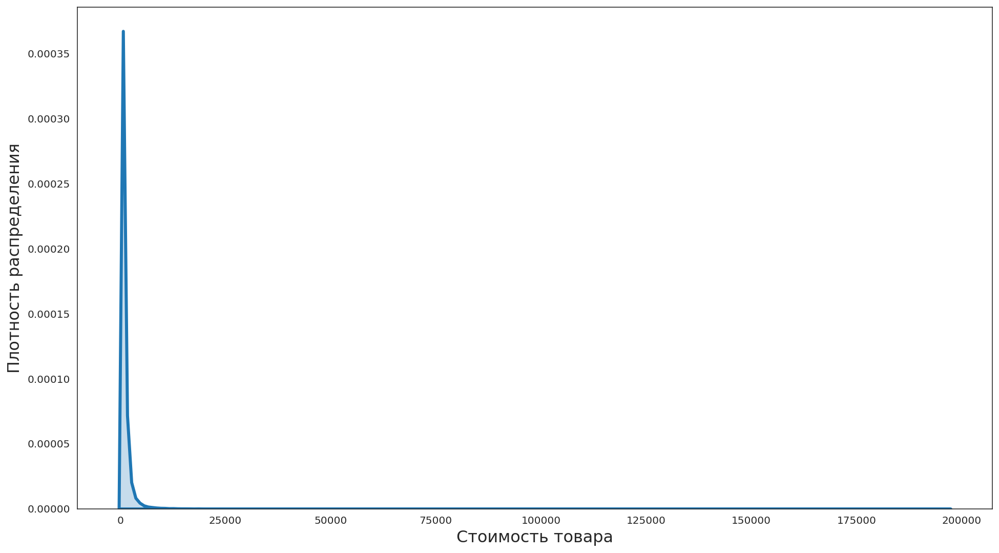

In [ ]:
plt.figure(figsize=(16, 9))
sns.set_style('white')
sns.kdeplot(all_products_df['min_sell_price'],
            linewidth=3,
            shade=True
        )
plt.ylabel('Плотность распределения', fontsize=16)
plt.xlabel('Стоимость товара', fontsize=16)

plt.show()

Не очень показательно... Выбрасывать товары необходимо на абы как, а применяя интерквантильный размах - грубо говоря, мы уберем только те значения, которых выходят за границы "типичных" значений.

#### **Распределение стоимости товара**

In [ ]:
q1 = all_products_df['min_sell_price'].quantile(q=0.05)
q3 = all_products_df['min_sell_price'].quantile(q=0.75)
iqr = q3 - q1

not_outliers_by_price = all_products_df[(all_products_df['min_sell_price'] > q1-1.5*iqr) & (all_products_df['min_sell_price'] < q3+1.5*iqr)]

In [ ]:
stacked_box_n_hist(not_outliers_by_price, 'min_sell_price', 'Распределение стоимости товара', 'Стоимость товара', 'Кол-во значений', [0, 400])

Если навести на синий квадрат, то можно увидеть, что средняя цена одного товара - 370 рублей, а медиана - 250. То есть половина всех товаров стоят меньше 250 рублей

При нажатии кнопки "Увеличить" выделяется область со стоимостью товаров от 0 до 400 рублей.

Посмотрим на среднюю стоимость товара в разрезе категорий. Скорее всего есть категории, где большинство товаров дороже общего среднего, например, бытовая техника.

#### **Распределение стоимости товара в разрезе категорий**

In [ ]:
grouped_mean_price = not_outliers_by_price.groupby(['title_lvl1'])['min_sell_price'].mean().reset_index().sort_values('min_sell_price', ascending=False).head(20).reset_index()
fig = px.bar(grouped_mean_price, 
             x='title_lvl1',
             y='min_sell_price',
             text_auto='.2s',
             color_discrete_sequence=["rgb(43, 44, 132)"],
             labels={
                     'title_lvl1': 'Категории верхнего уровня',
                     'min_sell_price': 'Стоимость товара'
                 },
            title=f"Самая высокая средняя стоимость товара в категории {grouped_mean_price.loc[0]['title_lvl1']}",
            height=600)

fig.update_traces(textfont_size=12, textangle=0, textposition="outside", cliponaxis=False)
fig.update_yaxes(title='Стоимость товара', visible=True, showticklabels=False)
fig.show()

Предположение оказалось верным, в категории "Бытовая техника" самая высокая средняя стоимость товара - 740 рублей. А вот сама низкая средняя стоимость в категории "Дача, сад и огород"

### Отзывы

Теперь посмотрим на отзывы клиентов. У нас доступна суммарное кол-во отзывов на каждом товаре. Посмотрим сколько в среднем оставляют отзывов клиенты. Не забудем про выбросы, т.к. у нас есть товары с 2-3 тысячими отзывов

#### **Распределение отзывов клиентов**

In [ ]:
q1 = all_products_df['feedback_quantity'].quantile(q=0.05)
q3 = all_products_df['feedback_quantity'].quantile(q=0.85)
iqr = q3 - q1

not_outliers_by_feedback = all_products_df[(all_products_df['feedback_quantity'] > q1-1.5*iqr) & (all_products_df['feedback_quantity'] < q3+1.5*iqr)]

In [ ]:
stacked_box_n_hist(not_outliers_by_feedback, 'feedback_quantity', 'Распределение отзывов клиентов', 'Кол-во отзывов', 'Кол-во значений', [0, 3])

Получились скромные результаты - 1.3 отзыва с среднем, оно и понятно, отзывы на товары где почти нет заказов отсутствуют. Посмотрим на распределение отзывов на товары, где более 100 заказов 

In [ ]:
stacked_box_n_hist(all_products_df[all_products_df['orders_quantity'] >= 100], 'feedback_quantity', 'Распределение отзывов клиентов', 'Кол-во отзывов', 'Кол-во значений', [0, 120])

Если нажать кнопку "Увеличить" и навести на синию область, видно, что в среднем клиенты оставляют около 30 отзывов на товары заказами от 100 штук. 

Чтобы чуть глубже понять поведение пользователей при оставлении отзывов подсчитаем прокси метрику - отношение кол-ва отзывывов к заказам. Возьмем только те продукты, где больше 10 заказов

Что мы можем понять? Условно, если товар купили 100 раз и на каждый заказ оставили по отзыву, метрика будет равна 1. Это значит, что клиенты максимально вовлечены в рекомендации товара посредством отзывов (либо сам маркетплейс за это вознаграждает)

#### **Отношение кол-ва отзывывов к заказам**

In [ ]:
all_products_df['orders_to_feedback'] = all_products_df['feedback_quantity'] / all_products_df['orders_quantity']
#all_products_df['orders_to_feedback'] = all_products_df['orders_to_feedback'].replace([np.inf, -np.inf], np.nan, inplace=True)
print(np.mean(all_products_df[(all_products_df['orders_to_feedback'] != np.inf) & (all_products_df['orders_quantity'] > 10)]['orders_to_feedback']))

0.0749614633056953


Получается, что около 7,5% пользователей оставляют отзывы на купленный товар. 

Посмотрим на этот показатель в разрезе категорий

#### **Отношение кол-ва отзывывов к заказам в разрезе категорий**

In [ ]:
grouped_order_feed = all_products_df[(all_products_df['orders_to_feedback'] != np.inf) & (all_products_df['orders_quantity'] > 10)].groupby(['title_lvl1'])['orders_to_feedback'].mean().reset_index().sort_values('orders_to_feedback', ascending=False).head(10).reset_index()
fig = px.bar(grouped_order_feed, 
             x='title_lvl1',
             y='orders_to_feedback',
             text_auto='.2s',
             color_discrete_sequence=["rgb(43, 44, 132)"],
             labels={
                     'title_lvl1': 'Категории верхнего уровня',
                     'orders_to_feedback': 'Отношение кол-ва отзывывов к заказам'
                 },
            title=f"Самое большое отношение кол-ва отзывывов к заказам в категории {grouped_order_feed.loc[0]['title_lvl1']}",
            height=600)

fig.update_traces(textfont_size=12, textangle=0, textposition="outside", cliponaxis=False)
fig.update_yaxes(title='Отношение кол-ва отзывывов к заказам', visible=True, showticklabels=False)
fig.show()

Если навести на первые два столбика, видно, что почти каждый десятый заказ переходит в оставление отзыва. И клиенты оставляют свои отзывы преимущственно в тех категориях, где есть условное деление товара на "подошел/не подошел" - Одежда и Обувь

### Заказы

Добрались до заказов, как и ранее, сначала посмотрим на распределение этого признака, опять же, не забывая про выбросы

#### **Распределение кол-ва заказов**

In [ ]:
q1 = all_products_df['orders_quantity'].quantile(q=0.05)
q3 = all_products_df['orders_quantity'].quantile(q=0.75)
iqr = q3 - q1

not_outliers_by_orders = all_products_df[(all_products_df['orders_quantity'] > q1-1.5*iqr) & (all_products_df['orders_quantity'] < q3+1.5*iqr)]

In [ ]:
stacked_box_n_hist(not_outliers_by_orders, 'orders_quantity', 'Распределение кол-ва заказов', 'Кол-во заказов', 'Кол-во значений', [0, 10])

В данном случае будем ориентироваться на медиану и получаем, что около 5 заказов приходитс на один товар.

Посмотрим теперь на самые продаваемые категории товаров

#### **Распределение отзывов по категориям**

In [ ]:
grouped_orders_cat = all_products_df.groupby(['title_lvl1'])['orders_quantity'].sum().reset_index().sort_values('orders_quantity', ascending=False).head(20).reset_index()
fig = px.bar(grouped_orders_cat, 
             x='title_lvl1',
             y='orders_quantity',
             text_auto='.2s',
             color_discrete_sequence=["rgb(43, 44, 132)"],
             labels={
                     'title_lvl1': 'Категории верхнего уровня',
                     'orders_quantity': 'Кол-во заказов'
                 },
             title=f"Самое большое кол-во заказов в категории {grouped_orders_cat.loc[0]['title_lvl1']}",
             height=600)

fig.update_traces(textfont_size=12, textangle=0, textposition="outside", cliponaxis=False)
fig.update_yaxes(title='Кол-во заказов', visible=True, showticklabels=False)
fig.show()

Итак, получаем, что чаще всего пользователи покупают товары для красоты, электронику и товары для дома.

Чтобы посмотреть на взаимосвязи трех признаков - цены товара, кол-во отзывов и кол-во заказов, построим матрицу попарных корреляций

#### **Матрица попарных корреляций**

In [200]:
# Строим график парных корреляций
fig = go.Figure()

fig.add_trace(go.Splom(
    dimensions=[
        dict(
            label='Заказы',
            values=not_outliers_by_price['orders_quantity']
        ),
        
        dict(
            label='Стоимость',
            values=not_outliers_by_price['min_sell_price']
        ),
        
        dict(
            label='Отзывы',
            values=not_outliers_by_price['feedback_quantity']
        )
    ]))

fig.update_layout(
    title='Матрица корреляций'
)

fig.show()

Что мы здесь наблюдаем?

1. По диагонали признаки пересекаются между собой, так что на это не смотрим
2. Есть положительная корреляция между кол-вом заказов и кол-вом отзывов, что логично объясняется тем, что банально большее кол-во заказов приводит влечет за собой увеличение отзывов
3. Нет корреляции у отзывов со стоимостью. То есть нет такого, что на дешевые товары клиенты не оставляют отзывы, на крупные покупки да.

Ради красоты посмотрим чуть детальнее на взаимосвять заказов и отзывов.

In [203]:
fig = px.scatter(not_outliers_by_price, x='orders_quantity', y='feedback_quantity', trendline="ols")
fig.update_layout(
    title='Диаграмма рассеяния по заказам и отзывам',
    yaxis_title='Кол-во отзывов',
    xaxis_title='Кол-во заказов'
)
fig.show(renderer="colab")

## ПВЗ

Теперь перейдем к пунктам выдачи заказов. У КЕ в очень хорошем состоянии справочник адресов, вплоть до указаний широты и долготы. Но, к сожалению, у нас нет регионов и чтобы получить эти данные воспользуймся сервисом Dadata, а именно API стандартизации.

Помимо этого, в рамках исследования ПВЗ хочется понять, насколько далеко эти пункты от центрального склада КЕ, то есть в теории можно понять примерный радиус от склада.

Для этого вычислим не просто расстояние по прямой (т.к. грузовые авто не по воздуху привозят товары до ПВЗ), а построим маршрут а-ля навигатор, то есть по дорогам. Сделаем условный яндекс навигатор, но бесплатный - воспользуемся Route API сервиса [Openrouteservice](https://openrouteservice.org/)

In [ ]:
delivery_points = get_cities_info(data)
delivery_points_df = pd.DataFrame(delivery_points)
delivery_points_df.head()

100%|██████████| 119/119 [00:00<00:00, 8401.03it/s]


,city_id,name,min_free_delivery_price_courier,min_free_delivery_price_dp,id,address,delivery_date,has_dressing_room,latitude,longitude,time_from,time_to
0,107,Агрыз,249000,14900,63334,"г. Агрыз, улица Пушкина, дом №1А",1667509200000,False,56.529541,52.997663,10:00,19:00
1,86,Азнакаево,199000,14900,63232,"г. Азнакаево, улица Ленина, дом №29",1667509200000,False,54.853163,53.078451,10:00,19:00
2,7,Альметьевск,249000,14900,63360,"г. Альметьевск, проспект Строителей, дом №68",1667509200000,False,54.891825,52.268735,10:00,19:00
3,7,Альметьевск,249000,14900,63272,"г. Альметьевск, улица Герцена, дом №80а",1667509200000,False,54.903835,52.331301,10:00,19:00
4,7,Альметьевск,249000,14900,63045,"г. Альметьевск, улица Ленина, дом №112",1667509200000,False,54.901691,52.265598,10:00,20:00


Начнем анализ с простого - посмотрим на то, в каком городе и в каком регионе больше всего открыто ПВЗ. Для этого загрузим ПВЗ с обогащенной информацией от Dadata

In [ ]:
standartized_address_df = pd.read_csv('/content/drive/MyDrive/Colab Notebooks/Job/PSB_Market/standartized_address.csv')
standartized_address_df = standartized_address_df[['source', 'result', 'postal_code', 'federal_district', 'region_iso_code', 'region_with_type']]
standartized_address_df = standartized_address_df.drop_duplicates().reset_index(drop=True)

In [ ]:
standartized_address_df.head()

,source,result,postal_code,federal_district,region_iso_code,region_with_type
0,"г. Агрыз, улица Пушкина, дом №1А","Респ Татарстан, г Агрыз, ул Пушкина, зд 1А",422230.0,Приволжский,RU-TA,Респ Татарстан
1,"г. Азнакаево, улица Ленина, дом №29","Респ Татарстан, г Азнакаево, ул Ленина, д 29",423332.0,Приволжский,RU-TA,Респ Татарстан
2,"г. Альметьевск, проспект Строителей, дом №68","Респ Татарстан, г Альметьевск, пр-кт Строителе...",423461.0,Приволжский,RU-TA,Респ Татарстан
3,"г. Альметьевск, улица Герцена, дом №80а","Респ Татарстан, г Альметьевск, ул Герцена, д 80А",423451.0,Приволжский,RU-TA,Респ Татарстан
4,"г. Альметьевск, улица Ленина, дом №112","Респ Татарстан, г Альметьевск, ул Ленина, д 112",423403.0,Приволжский,RU-TA,Респ Татарстан


#### **Крупнейшие города по присутствию ПВЗ КЕ**

In [ ]:
grouped_pvz_city = delivery_points_df.groupby(['name'])['city_id'].count().reset_index().sort_values('city_id', ascending=False).head(10).reset_index()
fig = px.bar(grouped_pvz_city, 
             x='name',
             y='city_id',
             text_auto='.2s',
             color_discrete_sequence=["rgb(43, 44, 132)"],
             labels={
                     'name': 'Наименование города',
                     'city_id': 'Кол-во точек ПВЗ'
                 },
            title=f"Самое большое кол-во точек ПВЗ в городе {grouped_pvz_city.loc[0]['name']}",
            height=600)

fig.update_traces(textfont_size=12, textangle=0, textposition="outside", cliponaxis=False)
fig.update_yaxes(title='Кол-во точек ПВЗ', visible=True, showticklabels=False)
fig.show()

#### **Крупнейшие регионы по присутствию ПВЗ КЕ**

In [ ]:
grouped_pvz_reg = standartized_address_df.groupby(['region_with_type'])['source'].count().reset_index().sort_values('source', ascending=False).head(10).reset_index()
fig = px.bar(grouped_pvz_reg, 
             x='region_with_type',
             y='source',
             text_auto='.2s',
             color_discrete_sequence=["rgb(43, 44, 132)"],
             labels={
                     'region_with_type': 'Наименование региона',
                     'source': 'Кол-во точек ПВЗ'
                 },
            title=f"Самое большое кол-во точек ПВЗ в регионе {grouped_pvz_reg.loc[0]['region_with_type']}",
            height=600)

fig.update_traces(textfont_size=12, textangle=0, textposition="outside", cliponaxis=False)
fig.update_yaxes(title='Кол-во точек ПВЗ', visible=True, showticklabels=False)
fig.show()

Результаты предсказуемы - КЕ сосредоточен в ПФО 🤔

Теперь перейдем в визуализации. Попробуем отобразить на интерактивной карте регионы, где есть присутствие КЕ + вывести точки ПВЗ в виде кластеров.

#### **Карта регионов присутствия с ПВЗ**

In [ ]:
gdf = geopandas.read_file(GEODATA)

slice_gdf = gdf[gdf['ref'].isin(list(standartized_address_df['region_iso_code'].unique()))]

In [ ]:
world_map = folium.Map(location=[57.205297, 48.270846], zoom_start=5)

folium.GeoJson(slice_gdf, name="geojson").add_to(world_map)

marker_cluster = MarkerCluster().add_to(world_map)

# iterate through dataset to create clusters

for row in delivery_points_df.itertuples():
#    folium.Marker(location=[row.latitude,  row.longitude], popup=row.address).add_to(marker_cluster)
    location = row.latitude, row.longitude
    marker = folium.Marker(location=location)
    popup = 'lon:{} lat:{}'.format(location[1], location[0])
    folium.Popup(popup).add_to(marker)
    marker_cluster.add_child(marker)

marker_cluster.add_to(world_map)

folium.LayerControl().add_to(world_map);

In [ ]:
world_map

Перейдем к расчету дистанции от склада КЕ до точек ПВЗ, для этого, как было сказано ранее, вычислим расстоения по дорогам.

#### **Расстояния от склада до ПВЗ**

In [ ]:
distance_raw_list = []
error_list = []
long_lat_dp = delivery_points_df[['id', 'longitude', 'latitude']].values.tolist()

for el in tqdm(long_lat_dp):
    print
    try:
        data = get_route(el[1], el[2], ke_long, ke_lat)
    except:
        error_list.append(el)

    distance_raw_list.append({
        'id': el[0],
        'distance': data['distance'],
        'duration': data['duration']
    })

  0%|          | 0/508 [00:00<?, ?it/s]

In [ ]:
distance_df = pd.DataFrame(distance_raw_list)
distance_df.head()

,id,distance,duration
0,63334.0,332,304
1,63232.0,329,311
2,63360.0,266,256
3,63272.0,270,262
4,63045.0,266,255


Данные мы получили, среднее расстояние вышло около 500 километров, а максимальное - 1 059 километров.


Теперь отобразим это расстояние на карте в виде круга с центром в точке склада

In [ ]:
distance_df['distance'].max()*1000

1059000

In [ ]:
ke_map = folium.Map(location=[57.205297, 48.270846], zoom_start=4.5)
folium.Circle(location=[ke_lat, ke_long], popup='KE Logistic', fill_color='#000', radius=1059000, weight=2, color="#000").add_to(ke_map)
ke_map

Неплохое расстояние, в теории, можно дотянуться и до МиМО

# Extra

In [206]:
%%shell
jupyter nbconvert --to html /content/PSB_Market_research_2.ipynb

[NbConvertApp] Converting notebook /content/PSB_Market_research_2.ipynb to html
[NbConvertApp] Writing 38450469 bytes to /content/PSB_Market_research_2.html
